In [1]:
# activate line execution
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# general
import numpy as np
import pandas as pd
import math
# import matplotlib.pyplot as plt
import os
import shutil
import pickle

# plotly
import plotly.express as px  # (version 4.7.0 or higher)
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import matplotlib.pyplot as plt

# import custom libraries
import sys
# sys.path.append("C:\\DATA\\Tasks\\lib\\hk")
# import hk_utils

# folder paths
ADD_DATA = "C:\\DATA\\data\\raw\\mimic4\\lookup\\"
ADD_DATA_proc = "C:/DATA/data/processed/"


PATH_PAPER = "C:\\DATA\\Tasks\\220704\\Alternate-Transactions-Articles-LaTeX-template\\images\\"


PATH_SYS="/mlodata1/hokarami/tedam/"

In [2]:
# libraries for THP

import argparse
import numpy as np
import pickle
import time
import torch
import torch.nn as nn
import torch.optim as optim
# from torch.utils.tensorboard import SummaryWriter

import transformer.Constants as Constants
import Utils

# from preprocess.Dataset import get_dataloader, get_dataloader2
# from transformer.Models import Transformer
# from transformer.hk_transformer import Transformer
from tqdm import tqdm

# from torchinfo import summary

os.environ['CUDA_LAUNCH_BLOCKING'] = "1"

# torch.cuda.empty_cache()
# torch.cuda.memory_allocated()
# torch.cuda.memory_reserved()

from sklearn import metrics
# from hk_pytorch import save_checkpoint,load_checkpoint
# import hk_pytorch


# from custom2 import myparser
import re

/opt/conda/envs/paper2022/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
import Main
import webbrowser


In [4]:
import io

In [5]:
from scipy import integrate

In [6]:
# sudo conda install -c conda-forge dash --name paper2022
# sudo conda install -c conda-forge jupyter-dash --name paper2022

In [7]:
from tsnecuda import TSNE
from MulticoreTSNE import MulticoreTSNE as TSNE

In [8]:
# !pip install wandb -qqq
import wandb
# wandb.login()
api = wandb.Api()
import os

os.environ["WANDB_API_KEY"] = "0f780ac8a470afe6cb7fc474ff3794772c660465"

os.environ["WANDB_NOTEBOOK_NAME"] = "jup_res"

# Functions

In [9]:
import io
import base64
import pickle
import gzip

import numpy as np

from jupyter_dash import JupyterDash
from dash import dcc, html, Input, Output, no_update
import dash_bootstrap_components as dbc
# sudo conda install -c conda-forge dash-bootstrap-components --name paper2022

import plotly.graph_objects as go

from PIL import ImageDraw, Image

from sklearn.manifold import TSNE

# Helper functions
def np_image_to_base64(im_matrix,scale=4):

    im_matrix = np.repeat(np.repeat(im_matrix,scale,axis=0),scale,axis=1)
    im = Image.fromarray(im_matrix)
    buffer = io.BytesIO()
    im.save(buffer, format="jpeg")
    encoded_image = base64.b64encode(buffer.getvalue()).decode()
    im_url = "data:image/jpeg;base64, " + encoded_image
    return im_url




def binary_matrix_to_image(binary_matrix, grid_size=8, border_size=1):
    # Calculate the size of the output image based on the size of the binary matrix
    height, width = binary_matrix.shape[:2]
    image_width = width * grid_size + (width + 1) * border_size
    image_height = height * grid_size + (height + 1) * border_size
    
    # Create a new image and a draw object to draw the grid and borders
    image = Image.new('RGB', (image_width, image_height), color='black')
    draw = ImageDraw.Draw(image)
    
    # Draw the white grids
    for i in range(height):
        for j in range(width):
            if binary_matrix[i, j] == 1:
                x1 = j * (grid_size + border_size) + border_size
                y1 = i * (grid_size + border_size) + border_size
                x2 = x1 + grid_size
                y2 = y1 + grid_size
                draw.rectangle((x1, y1, x2, y2), fill='white')
                
    
    # Draw the black borders
    for i in range(height + 1):
        y = i * (grid_size + border_size)
        draw.line((0, y, image_width, y), fill='white', width=border_size)
        
    for j in range(width + 1):
        x = j * (grid_size + border_size)
        draw.line((x, 0, x, image_height), fill='white', width=border_size)
        
    return image

In [10]:
def map_to_rgb(num, **rgb_params):
    
    
    
    if len(rgb_params)>0:

        normalized = (num - rgb_params['offset'])/rgb_params['range']

        
        # Map to a color between blue, gray, and red
        rgb_lower = rgb_params['rgb_lower']
        rgb_middle = rgb_params['rgb_middle']
        rgb_upper = rgb_params['rgb_upper']
    else:
    
        # Normalize to the range of 0 to 1
    
    
    
        normalized = (num + 2) / 4
        
        # Map to a color between blue, gray, and red
        rgb_lower = (0, 0, 255,1)
        rgb_middle = (128, 128, 128,1)
        rgb_upper = (255, 0, 0,1)
    
    if normalized < 0.5:
        r = int((2 * normalized) * rgb_middle[0] + (1 - 2 * normalized) * rgb_lower[0])
        g = int((2 * normalized) * rgb_middle[1] + (1 - 2 * normalized) * rgb_lower[1])
        b = int((2 * normalized) * rgb_middle[2] + (1 - 2 * normalized) * rgb_lower[2])
        a = int((2 * normalized) * rgb_middle[3] + (1 - 2 * normalized) * rgb_lower[3])
    else:
        r = int((2 * normalized - 1) * rgb_upper[0] + (2 - 2 * normalized) * rgb_middle[0])
        g = int((2 * normalized - 1) * rgb_upper[1] + (2 - 2 * normalized) * rgb_middle[1])
        b = int((2 * normalized - 1) * rgb_upper[2] + (2 - 2 * normalized) * rgb_middle[2])
        a = int((2 * normalized - 1) * rgb_upper[3] + (2 - 2 * normalized) * rgb_middle[3])
    
    # if normalized>0.5:
    #     print(normalized,a,rgb_upper[3])
    #     term
    return (r, g, b,a)


In [11]:
import numpy as np
from PIL import ImageDraw, Image, ImageFont

def binary_matrix_to_image(binary_matrix, row_labels=None, font_path=None, grid_size=10, border_size=1, label_size=15, is_fill=True,**rgb_params):
    # Add a dummy column to the binary matrix
    ddd=2

    height, width = binary_matrix.shape[:2]
    binary_matrix = np.concatenate((np.zeros((height, ddd)), binary_matrix), axis=1)
    width += ddd
    
    # Calculate the size of the output image based on the size of the binary matrix
    image_width = (width + 1) * grid_size + (width + 2) * border_size
    image_height = height * grid_size + (height + 1) * border_size
    
    # Create a new image and a draw object to draw the grid and borders
    image = Image.new('RGBA', (image_width, image_height), color=(0,0,0,0))
    draw = ImageDraw.Draw(image)
    
    # Draw the white grids
    for i in range(height):
        for j in range(1, width):
            # if binary_matrix[i, j] == 1:
            #     x1 = j * (grid_size + border_size) + border_size
            #     y1 = i * (grid_size + border_size) + border_size
            #     x2 = x1 + grid_size
            #     y2 = y1 + grid_size
            #     draw.rectangle((x1, y1, x2, y2), fill='white')

            if binary_matrix[i, j] != 0:
                x1 = j * (grid_size + border_size) + border_size
                y1 = i * (grid_size + border_size) + border_size
                x2 = x1 + grid_size
                y2 = y1 + grid_size

                int_color = ( int(binary_matrix[i, j]*96),
                             int(binary_matrix[i, j]*96),
                             int(binary_matrix[i, j]*96))

                
                int_color = map_to_rgb(binary_matrix[i, j], **rgb_params)
                if is_fill:
                    draw.rectangle((x1, y1, x2, y2), fill= int_color)
                else:
                    draw.rectangle((x1, y1, x2, y2), outline=int_color,width=2, fill= None)


    # Draw the borders
    color_border = (0,0,0,16)
    for i in range(height + 1):
        y = i * (grid_size + border_size)
        draw.line((grid_size, y, image_width, y), fill=color_border, width=border_size)
        
    for j in range(width + 1):
        x = j * (grid_size + border_size)
        draw.line((x, 0, x, image_height), fill=color_border, width=border_size)

    
    # Draw the row labels
    if row_labels is not None:
        font = ImageFont.truetype(PATH_SYS+'arial.ttf', size=label_size)
        max_label_width = max([font.getsize(str(label))[0] for label in row_labels])
        label_x = 0
        label_y = border_size
        for i, label in enumerate(row_labels):
            draw.text((label_x, label_y), str(label), font=font, fill='black',align="right")
            label_y += grid_size + border_size
            # if i == 0:
            #     label_x += max_label_width + border_size + grid_size
        
    return image


In [12]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

def create_barplot_image(data, labels, filename):
    """
    Creates a bar plot image of the input data and saves it as a PNG file with the given filename.

    Args:
        data (numpy.ndarray): A 1D array of data to plot.
        labels (list): A list of labels for each data point.
        filename (str): The name of the output PNG file.

    Returns:
        PIL.Image.Image: A PIL image object of the bar plot.
    """
    # Create a figure and axis object
    fig, ax = plt.subplots()

    # Create a bar plot
    _ = ax.bar(np.arange(len(data)), data)

    # Set axis labels and title
    _ = ax.set_xlabel('Index')
    _ = ax.set_ylabel('Value')
    _ = ax.set_title('Bar plot')

    # Set x-tick labels
    _ = ax.set_xticks(np.arange(len(data)))
    _ = ax.set_xticklabels(labels, rotation=45)

    # Save the plot as a PNG file
    _ = fig.savefig(filename)
    plt.close(fig)
    # Load the PNG image and return as a PIL image object
    return Image.open(filename)


In [13]:
def event2mat(event_type, event_time,P):

    m = event_type.sum(1)>0 # False are masked
    e=event_type[m,:]
    t=event_time[m]
    # print(t)

    indices = e.nonzero()
    indices[:,0] = t[indices[:,0]].int()
    # print(t[indices[:,0]])
    # print(indices[:,0])

    M = torch.zeros((P, e.shape[-1]))
    M[indices[:,0],indices[:,1]]=1

    return M.detach().cpu().numpy().transpose() # [M,P]

def att_event2mat(event_type, event_time,P, tee_att):
    # tee_att [h,L]
    h = tee_att.shape[0]

    m = event_type.sum(1)>0 # False are masked
    e=event_type[m,:]
    t=event_time[m]
    tee_att = tee_att[:,m]

    # indices = e.nonzero()
    # indices[:,0] = t[indices[:,0]].int()

    # M = torch.zeros(h, len(t))
    M = torch.zeros(( h , P))

    M[:,t.long()]=tee_att

    return M.detach().cpu().numpy() # [h,L]

In [14]:
def state2mat(time, mod,M):
    P = time.int().max().item() + 1

    M = torch.zeros(P, M)
    M[time[mod!=0].long(), mod[mod!=0]-1] = 1


    return M.cpu().numpy().transpose() # [M,P]

def att_state2mat(time, mod,M, dam_att):
    # dam_att [P,h]
    # h = dam_att.shape[-1]

    # dam_att = dam_att[:,0] # [P]
    P = time.int().max().item() + 1

    M = torch.zeros(P, M)
    
    M[time[mod!=0].long(),  mod[mod!=0]-1] = dam_att[mod!=0]


    return M.cpu().numpy().transpose() # [M,P]

## cool_image

In [35]:
def cool_image(out,i_b,i,opt,CROP=0):

    att_mat_img=None
    img_ev=None

    label_size = 12
    rgb_params_values = {
    'rgb_lower':(0, 0, 255,255),
    'rgb_middle':(128, 128, 128,255),
    'rgb_upper':(255, 0, 0,255),
    'offset':-2,
    'range':4

    }
    rgb_params_events = {
    'rgb_lower':(255, 255, 255,255),
    'rgb_middle':(196, 196, 196,255),
    'rgb_upper':(128, 128, 128,255),
    'offset':0,
    'range':1

    }
    rgb_params_events_pred = {
    'rgb_lower':(255, 255, 255,255),
    'rgb_middle':(128, 255, 128,255),
    'rgb_upper':(0, 255, 0,255),
    'offset':0,
    'range':1

    }
    # rgb_params_att = {
    #     'rgb_lower':(64, 64, 64,0),
    #     'rgb_middle':(164, 164, 32,32),
    #     'rgb_upper':(255, 255, 0,255),
    #     'offset':0,
    #     'range':0.1

    # }


    rgb_params_att = {
        'rgb_lower':(128, 128, 128,32),
        # 'rgb_middle':(8, 164, 32,196),
        'rgb_upper':(0, 255, 0,255),
        'offset':0,
        'range':0.2

    }


    rgb_params_att['rgb_middle'] = tuple([(int(i+j)/2) for i,j in zip(rgb_params_att['rgb_lower'],rgb_params_att['rgb_upper'])])
    rgb_params_att['rgb_middle']
    if hasattr(opt,'dict_map_states' ):
        state_labels = list(opt.dict_map_states.keys())[CROP:]
        state_labels = [str(i) for i in range(len(opt.dict_map_states))]

    if hasattr(opt,'dict_map_events' ):
        offset=len(opt.dict_map_states.keys())-len(opt.dict_map_events.keys())
        event_labels = list(opt.dict_map_events.keys())
        event_labels = [str(i+offset) for i in range(len(opt.dict_map_events))]


    # event_labels = opt.dict_map_events.keys()
    

    # if len(out['event_type_list']) > 0:
    

    if len(out['state_time_list']) > 0:
        st=out['state_time_list'][i_b][i]
        sm=out['state_mod_list'][i_b][i]
        sv=( out['state_value_list'][i_b][i] )

        dam_att = out['list_DAM_att'][i_b][i] # [P,h]

        n_state_mods = len(opt.dict_map_states.keys())

        # ev.shape, t.shape
        P = st.int().max().item() + 1

        
        # list_img_att = []
        # for i_head in range(dam_att.shape[-1]):
        #     binary_matrix = att_state2mat(st, sm, n_state_mods, dam_att[:,i_head])
        #     img_att = binary_matrix_to_image(binary_matrix, row_labels=state_labels, font_path=None, grid_size=10, border_size=1, label_size=label_size,is_fill=False,**rgb_params_att)
        #     list_img_att.append(img_att.convert("RGB"))

        binary_matrix = att_state2mat(st, sm, n_state_mods, dam_att.sum(1))[CROP:,:]
        # print(f'binary_matrix.shape={binary_matrix.shape}')
        
        img_att = binary_matrix_to_image(binary_matrix, row_labels=state_labels, font_path=None, grid_size=10, border_size=2, label_size=label_size,is_fill=False,**rgb_params_att)


        binary_matrix = att_state2mat(st, sm, n_state_mods, sv)[CROP:,:]
        img_val = binary_matrix_to_image(binary_matrix, row_labels=state_labels, font_path=None, grid_size=10, border_size=1, label_size=label_size,is_fill=True,**rgb_params_values)

        merged_img = Image.new('RGBA', img_val.size)
        merged_img = Image.alpha_composite(merged_img, img_val)
        # merged_img = Image.alpha_composite(merged_img, img_att)#.convert("RGB")

        if opt.event_enc:
            ev = out['event_type_list'][i_b][i]
            t = out['event_time_list'][i_b][i]
            
            ev_pred = out['next_event_type_list'][i_b][i]


            m = (ev.sum(1)>0).sum() # False are masked
            ev=ev[:m]
            ev_pred=ev_pred[:m-1] # for 2 to L-1
            ev_pred = nn.functional.pad(ev_pred,(0,0,1,0))
            t=t[:m]


            print(f'm={m}')

            print(f'ev.shape={ev.shape}')
            print(f'ev_pred.shape={ev_pred.shape}')

                                # plot attention of last event
            tee_att = out['list_TE_att'][i_b][i,:,m-1,:m] # [h,L]
            print(f'tee_att.shape={tee_att.shape}')
            # print(tee_att)
            

                                
            # att_names = [f'h{i}' for i in range(tee_att.shape[0])]
            # rgb_params_att['range']=tee_att.max()
            # binary_matrix = att_event2mat(ev, t,P, tee_att)

            # img_att_ev = binary_matrix_to_image(binary_matrix, row_labels=att_names, font_path=None, grid_size=10, border_size=1, label_size=label_size,is_fill=False,**rgb_params_att)
            
            # merged_img2 = Image.new('RGBA', (merged_img.size[0],merged_img.size[1]+img_att_ev.size[1]))
            # merged_img2.paste(merged_img, (0,0))
            # merged_img2.paste(img_att_ev, (0,merged_img.size[1]))
            # merged_img = merged_img2



                                # plot attention matrix
            m = (ev.sum(1)>0).sum() # False are masked
            tee_att_mat = out['list_TE_att'][i_b][i,:,:m,:m].mean(0) # [L,L]
            
            print(f'tee_att_mat.shape={tee_att_mat.shape}')
            
            # print(tee_att_mat.sum(1))
            scaler=torch.arange(1,m+1)[:,None]
            scaler= (1/tee_att_mat.max(1)[0])[:,None]
            tee_att_mat *= scaler
            rgb_params_att['range']=tee_att_mat.max()
            # print(tee_att_mat.max(1))

            # print(tee_att_mat[1])

            tee_att_mat_spaced = att_event2mat(ev, t,P, tee_att_mat)
            print(f'tee_att_mat_spaced.shape={tee_att_mat_spaced.shape}')

            binary_matrix = tee_att_mat_spaced
            img_val = binary_matrix_to_image(binary_matrix, row_labels=None, font_path=None, grid_size=10, border_size=1, label_size=label_size,is_fill=True,**rgb_params_att)

            att_mat_img = Image.new('RGBA', img_val.size)
            att_mat_img = Image.alpha_composite(att_mat_img, img_val)


            # t=torch.arange(m)
            # PP = t.int().max().item() + 1

            print(t[:m])
            ev_matrix = event2mat(ev,t,P)
            print(f'ev_matrix.shape={ev_matrix.shape}')
            print(P)
            img_ev = binary_matrix_to_image(ev_matrix, row_labels=event_labels, font_path=None, grid_size=10, border_size=1, label_size=label_size,**rgb_params_events)


            ev_pred_matrix = event2mat(ev_pred,t,P)
            print(f'ev_pred_matrix.shape={ev_pred_matrix.shape}')

            img_ev_pred = binary_matrix_to_image(ev_pred_matrix, row_labels=None, font_path=None, grid_size=10, border_size=1,is_fill=False, label_size=label_size,**rgb_params_events_pred)
            
            merged_img3 = Image.new('RGBA', (att_mat_img.size[0],att_mat_img.size[1]+img_ev.size[1]))
            merged_img3.paste(att_mat_img, (0,0))
            merged_img3.paste(img_ev, (0,att_mat_img.size[1]))
            merged_img3.paste(img_ev_pred, (0,att_mat_img.size[1]))

            temp_img = Image.new('RGBA', img_ev.size)
            temp_img = Image.alpha_composite(temp_img, img_ev)
            temp_img = Image.alpha_composite(temp_img, img_ev_pred)#.convert("RGB")

            merged_img3.paste(temp_img, (0,att_mat_img.size[1]))

            att_mat_img = merged_img3



    else:
        
        ev = out['event_type_list'][i_b][i]
        t = out['event_time_list'][i_b][i]
        P = t.int().max().item() + 1
        m = (ev.sum(1)>0).sum() # False are masked

        tee_att = out['list_TE_att'][i_b][i,:,m-2,:m] # [h,L]
        att_names = [f'h{i}' for i in range(tee_att.shape[0])]
        rgb_params_att['range']=tee_att.max()

        binary_matrix = event2mat(ev,t,P)
        img_ev = binary_matrix_to_image(binary_matrix, row_labels=event_labels, font_path=None, grid_size=10, border_size=1, label_size=label_size,**rgb_params_events)

        binary_matrix = att_event2mat(ev, t,P, tee_att)
        img_att_ev = binary_matrix_to_image(binary_matrix, row_labels=None, font_path=None, grid_size=10, border_size=1, label_size=label_size,is_fill=False,**rgb_params_att)
            
        # print(binary_matrix.sum())
        merged_img = Image.new('RGB', (img_ev.size[0],img_ev.size[1]+img_att_ev.size[1]))
        merged_img.paste(img_ev, (0,0))
        merged_img.paste(img_att_ev, (0,img_ev.size[1]))



        # plot attention matrix
        m = (ev.sum(1)>0).sum() # False are masked
        tee_att_mat = out['list_TE_att'][i_b][i,:,:m,:m].mean(0) # [L,L]

        binary_matrix = tee_att_mat
        img_val = binary_matrix_to_image(binary_matrix, row_labels=None, font_path=None, grid_size=10, border_size=1, label_size=label_size,is_fill=True,**rgb_params_att)
        
        att_mat_img = Image.new('RGBA', img_val.size)
        att_mat_img = Image.alpha_composite(att_mat_img, img_val)


    return merged_img,(att_mat_img,img_ev)#(img_att.convert("RGB"), img_val.convert("RGB"))

NUM:3096


In [16]:
def bar_summary(df,out, point_ids,res_labels, fig=None):

    if fig is None:
        fig = go.Figure()



    list_summary = []
    for pid in point_ids:

        i_b = df.iloc[pid]['i_b']
        i = df.iloc[pid]['i']

        ev = out['event_type_list'][i_b][i]
        t = out['event_time_list'][i_b][i]
        st=out['state_time_list'][i_b][i]
        
        P = st.int().max().item() + 1

        M = event2mat(ev,t,P)


        vector = M.sum(1)/M.shape[1]*24
        list_summary.append(vector)

    vec_mean = np.mean(list_summary,axis=0)
    vec_std = np.std(list_summary,axis=0)

    sum(vec_std)

    
    _ = fig.add_trace(go.Bar(
        name=f'Summary',
        x=list(res_labels), y=vec_mean,
        error_y=dict(type='data', array=vec_std)
    ))

    return fig

In [17]:
def read_from_wandb(run_path):

    run = api.run(run_path)
    for file in run.files():
        file.download(replace=True,root=f'./local/{run_path}/')

    opt = pickle.load(open(f'./local/{run_path}/opt.pkl','rb'))
    opt = Main.config(opt, justLoad=True)

    checkpoint = torch.load(f'./local/{run_path}/best_model.pkl')

    model = Main.ATHP(
       n_marks=opt.num_marks,
        TE_config = opt.TE_config,
        DAM_config = opt.DAM_config,
        NOISE_config = opt.NOISE_config,

        CIF_config = opt.CIF_config,
        next_time_config = opt.next_time_config,
        next_type_config = opt.next_type_config,
        label_config = opt.label_config,

        demo_config = opt.demo_config,

        device=opt.device,
    )

    _ = model.to(opt.device)
    _ = model.load_state_dict(checkpoint['model_state_dict'])
    _ = model.eval()

    return model, opt, run

## summary

In [58]:
def find_knn_pids (X, id_origin, n_knn=10):

    # X [N,d] np.array
    r = np.sqrt(   ((X-X[id_origin])**2).sum(-1)   )
    knn_pids = list(np.argpartition(r,n_knn)[:n_knn])

    if id_origin not in knn_pids:
        print('bad')
    else:
        knn_pids.remove(id_origin)

    # print(X.shape)
    # term

    
    # x0 = df.iloc[id_origin]['x']
    # y0 = df.iloc[id_origin]['y']

    # df['r'] = df.apply(lambda row: ( (row['x']-x0)**2 + (row['y']-y0)**2  ), axis=1)

    # knn_pids = list(df.nsmallest(n_knn,'r').index)


    return knn_pids

def cal_similarity(df, out, pid, knn_pids):

    list_summary = []
    for pid in knn_pids:
        

        i_b = df.iloc[pid]['i_b']
        i = df.iloc[pid]['i']

        ev = out['event_type_list'][i_b][i]
        t = out['event_time_list'][i_b][i]
        st=out['state_time_list'][i_b][i]
        
        P = st.int().max().item() + 1

        M = event2mat(ev,t,P)

        

        vector = M.sum(1)/M.shape[1]*24

        
        list_summary.append(vector)
        

    dotp = [ np.dot(j,list_summary[0])/(np.linalg.norm(j) * np.linalg.norm(list_summary[0])) for  j in list_summary]
    sim_score = np.mean( dotp )


    return sim_score, list_summary




## cif

In [19]:
def plot_cif(out,i_b,i, fig=None):

    ev = out['event_type_list'][i_b][i]
    t = out['event_time_list'][i_b][i]


    tee_att = out['list_TE_att'][i_b][i,:,-4,:] # [h,L]
    cifs = out['list_intens_at_samples'][i_b][i]
    taus = out['list_taus'][i_b][i]

    y_cifs = out['list_true_intens_at_evs'][i_b][i] # [L-1] 2 to L

    P = t.int().max().item() + 1

    m = ev.sum(1)>0 # False are masked
    m = m.sum().item()

    
    taus = taus[:m-1,:,:] + t[:m-1,None,None]
    cifs = cifs[:m-1,:,:]
    y_cifs = y_cifs[:m-1,:]  # 1 to L-1


    n_cifs=cifs.shape[1]
    # print(n_cifs,taus.shape, cifs.shape)

    cifs = cifs.reshape(n_cifs,-1)[0] # [0] is the first cif
    taus = taus.reshape(1,-1)[0]
    y_cifs = y_cifs.reshape(n_cifs,-1)[0]

    print(taus)
    print(cifs)
    # print(n_cifs,taus.shape, cifs.shape)
    temp = torch.argsort(taus)

    taus = taus[temp]
    cifs = cifs[temp]


    if fig==None:
        fig=go.Figure()

    _ = fig.add_trace(go.Scatter(x=taus,y=cifs))

    # _ = fig.add_trace(go.Scatter(x=t[1:m],y=y_cifs*0+1,mode='markers'))
    # _ = fig.add_trace(go.Scatter(x=t[1:m],y=t[1:m],mode='markers'))

    # print(m)
    # print(t[1:5])
    # print(y_cifs[:4])

    _ = fig.add_trace(go.Scatter(x=t[:m],y=t[:m]*0,mode='markers'))

    _ = fig.add_trace(go.Scatter(x=t[1:m],y=y_cifs,mode='markers'))


    

    return fig

In [20]:
def plot_cif_cum(out,i_b,i, fig=None):

    ev = out['event_type_list'][i_b][i]
    t = out['event_time_list'][i_b][i]


    tee_att = out['list_TE_att'][i_b][i,:,-4,:] # [h,L]
    cifs = out['list_intens_at_samples'][i_b][i]
    taus = out['list_taus'][i_b][i]

    y_cifs = out['list_true_intens_at_evs'][i_b][i] # [L-1] 2 to L

    P = t.int().max().item() + 1

    m = ev.sum(1)>0 # False are masked
    m = m.sum().item()

    taus = taus[:m-1,:,:] + t[:m-1,None,None]
    cifs = cifs[:m-1,:,:]
    y_cifs = y_cifs[:m-1,:]  # 1 to L-1


    n_cifs=cifs.shape[1]

    cifs = cifs.reshape(n_cifs,-1)[0]
    taus = taus.reshape(n_cifs,-1)[0]
    y_cifs = y_cifs.reshape(n_cifs,-1)[0]

    temp = torch.argsort(taus)

    taus = taus[temp]
    cifs = cifs[temp]

    cifs_int = integrate.cumulative_trapezoid(cifs, taus, initial=0)/(taus)

    if fig==None:
        fig=go.Figure()

    _ = fig.add_trace(go.Scatter(x=taus,y=cifs_int))

    # _ = fig.add_trace(go.Scatter(x=t[1:m],y=y_cifs*0+1,mode='markers'))
    # _ = fig.add_trace(go.Scatter(x=t[1:m],y=t[1:m],mode='markers'))

    # print(m)
    # print(t[1:5])
    # print(y_cifs[:4])

    _ = fig.add_trace(go.Scatter(x=t[:m],y=t[:m]*0,mode='markers'))

    # _ = fig.add_trace(go.Scatter(x=t[1:m],y=y_cifs,mode='markers'))


    

    return fig

In [21]:
def cif_cum(out,i_b,i, fig=None):

    ev = out['event_type_list'][i_b][i]
    t = out['event_time_list'][i_b][i]


    tee_att = out['list_TE_att'][i_b][i,:,-4,:] # [h,L]
    cifs = out['list_intens_at_samples'][i_b][i]
    taus = out['list_taus'][i_b][i]

    y_cifs = out['list_true_intens_at_evs'][i_b][i] # [L-1] 2 to L

    P = t.int().max().item() + 1

    m = ev.sum(1)>0 # False are masked
    m = m.sum().item()

    taus = taus[:m-1,:,:] + t[:m-1,None,None]
    cifs = cifs[:m-1,:,:]
    y_cifs = y_cifs[:m-1,:]  # 1 to L-1


    n_cifs=cifs.shape[1]

    cifs = cifs.reshape(n_cifs,-1)[0]
    taus = taus.reshape(n_cifs,-1)[0]
    y_cifs = y_cifs.reshape(n_cifs,-1)[0]

    temp = torch.argsort(taus)

    taus = taus[temp]
    cifs = cifs[temp]

    cifs_int = integrate.cumulative_trapezoid(cifs, taus, initial=0)/(taus)

    if fig==None:
        fig=go.Figure()

    _ = fig.add_trace(go.Scatter(x=taus,y=cifs_int))

    # _ = fig.add_trace(go.Scatter(x=t[1:m],y=y_cifs*0+1,mode='markers'))
    # _ = fig.add_trace(go.Scatter(x=t[1:m],y=t[1:m],mode='markers'))

    # print(m)
    # print(t[1:5])
    # print(y_cifs[:4])

    _ = fig.add_trace(go.Scatter(x=t[:m],y=t[:m]*0,mode='markers'))

    # _ = fig.add_trace(go.Scatter(x=t[1:m],y=y_cifs,mode='markers'))


    

    return taus,cifs_int

# Model path

In [22]:
runs_path=[
# "hokarami/TEEDAM_supervised/5uzxzoxd",
"hokarami/TEEDAM_supervised/sb9zf1mm",
"hokarami/TEEDAM_supervised/hue1qxw4",  # seft [Q10-TE__nextmark-concat]1566371 with label

# "hokarami/TEEDAM_supervised/t43m0t0u", # [Q10-DA__base-concat]1563864

"hokarami/TEEDAM_supervised/9gxq3dgy", # [Q10-TEDA__nextmark-concat]1577576 with label

"hokarami/TEEDAM_supervised/56ecgyrq", # [Q20-TEDA__nextmark-concat]1588433
# "hokarami/TEEDAM_supervised/g4x0ibmk", # [Q20-TE__nextmark-concat]1585936 with label

# "hokarami/TEEDAM_supervised/lzvf7erg", # [Q20-DA__base-concat]1586915

]

run_path = runs_path[-1]
run_path


# run = api.run(run_path)
# for file in run.files():
#     file.download(replace=True,root='./local/')

'hokarami/TEEDAM_supervised/56ecgyrq'

# ATT

In [23]:
# out.keys()
# bs = opt.batch_size


# out['event_type_list'][0].shape
# out['event_time_list'][0].shape
# out['non_pad_mask_list'][0].shape
# out['list_TE_att'][0].shape

# out['state_mod_list'][0].shape
# out['list_DAM_att'][0].shape

# out['y_state_true'].shape




In [24]:
# binary_matrix = state2mat(st, sm,n_state_mods)

# # binary_matrix_to_image(binary_matrix, row_labels=state_labels, font_path=None, grid_size=10, border_size=1, label_size=8)


# M = [state2mat(st, sm,n_state_mods) +  att_state2mat(st, sm, n_state_mods, dam_att.sum(1))*0,
     
#      att_event2mat(ev, t,P, tee_att)*12
     
#      ]

# all_labels = [*state_labels,
#               *[f"Head_{i}" for i in range(tee_att.shape[0])]
#               ]
# binary_matrix = np.concatenate(M, axis=0)

# # binary_matrix_to_image(binary_matrix, row_labels=all_labels, font_path=None, grid_size=10, border_size=1, label_size=8)


# # binary_matrix = event2mat(ev,t,P)
# # event_labels = opt.dict_map_events.keys()

# # binary_matrix_to_image(binary_matrix, row_labels=None, font_path=None, grid_size=10, border_size=1, label_size=8)


# binary_matrix = att_state2mat(st, sm, n_state_mods, dam_att.sum(1))
# img_att = binary_matrix_to_image(binary_matrix, row_labels=state_labels, font_path=None, grid_size=10, border_size=1, label_size=8,is_fill=False,**rgb_params_att)


# binary_matrix = att_state2mat(st, sm, n_state_mods, sv)
# img_val = binary_matrix_to_image(binary_matrix, row_labels=state_labels, font_path=None, grid_size=10, border_size=1, label_size=8,is_fill=True,**rgb_params_values)




In [25]:
# # binary_matrix[binary_matrix!=0].shape
# # binary_matrix.shape
# # binary_matrix.min()
# # binary_matrix.max()

# i_b=3
# i=18

# merged_img,temp = cool_image(out,i_b,i,opt)

# temp[2][0]
# temp[2][1]
# temp[0]
# merged_img

# map_to_rgb(-0)

In [26]:
# if 'y_state_true' in out:

#     y_state_pred = out['y_state_pred']
#     y_state_true = out['y_state_true']
#     y_state_score = out['y_state_score']
# else:
#     y_state_pred = None
#     y_state_true = None
#     y_state_score = None

# y_pred = out['y_pred']
# y_true = out['y_true']
# y_score = out['y_score']


# res=list()


# if len(out['state_mod_list'])>0 and 0:

#     res_labels = opt.dict_map_states.keys()

#     n_cols = len(opt.dict_map_states.keys())

#     state_mod_list = out['state_mod_list']
#     state_time_list = out['state_time_list']
#     len(state_mod_list)
#     state_mod_list[0].shape

#     for state_mod,state_time in zip(state_mod_list,state_time_list):
#         xs = torch.unbind(state_time,0)
#         ys = torch.unbind(state_mod,0)

#         for x,y in zip(xs,ys):
#             # y = y[y~=0]
#             n_rows = x.int().max().item() + 1
#             matrix = torch.zeros(n_rows, n_cols)
#             matrix[x[y!=0].long(), y[y!=0]-1] = 1
#             res.append(matrix.cpu().numpy().transpose()) # [n_marks * times]


# else:
#     non_pad_mask_list = out['non_pad_mask_list']
#     event_type_list = out['event_type_list']
#     event_time_list = out['event_time_list']

#     event_type_list[0].shape
#     non_pad_mask_list[0].shape

#     num_marks = event_type_list[0].shape[-1]
#     res_labels = opt.dict_map_events.keys()



#     for event_type, event_time, non_pad_mask in zip(event_type_list,event_time_list,non_pad_mask_list):

#         B = event_type.shape[0]
#         for i in range(B):
#             m = non_pad_mask[i]
#             e=event_type[i,:m.sum().int(),:]
#             t=event_time[i,:m.sum().int()]
            
#             indices = e.nonzero()
#             indices[:,0] = t[indices[:,0]]

#             M = torch.zeros((indices[:,0].max()+1, e.shape[-1]))
#             M[indices[:,0],indices[:,1]]=1


#             res.append( M.cpu().numpy().astype(np.uint8).transpose() )


#         # temp = torch.unbind(event_type,0)
#         # lens = non_pad_mask.sum(1).long()
#         # term
#         # for i,x in enumerate(temp):
#         #     res.append( x[:lens[i],:].cpu().numpy().astype(np.uint8).transpose() )




# res[1].shape

# len(res_labels)
# res_labels




# # for i,pattern in enumerate(res):
# #     image = Image.fromarray(pattern)


# #     # row_labels = opt.dict_map_states.keys()
# #     # image = binary_matrix_to_image(pattern, row_labels=row_labels, grid_size=50, border_size=2, label_size=20)
# #     # image.save(f'./local/images/img{i}.jpeg')
# all_images = [f'./local/images/img{i}.jpeg' for i in range(len(res))]

# Visualizations

## TSNE of Learned Rep

In [27]:
TSNE_LIMIT = 6000

def compute_tsne(r_enc_list, model):
    tsne = TSNE(n_components=2, perplexity=30, learning_rate=10,n_jobs=4)

    # r_enc_list = out['r_enc_list']

    X = np.concatenate(r_enc_list,axis=0)[:,:]
    X_tsne = tsne.fit_transform(X[:TSNE_LIMIT,:])

    X_tsne_split=dict()
    if model.d_out_te>0:
        X_te = np.concatenate(r_enc_list,axis=0)[:,:model.d_out_te]
        X_te_tsne = tsne.fit_transform(X_te[:TSNE_LIMIT,:])
        X_tsne_split['tee']=X_te_tsne

    if model.d_out_dam>0:    
        X_dam = np.concatenate(r_enc_list,axis=0)[:,model.d_out_te:]
        X_dam_tsne = tsne.fit_transform(X_dam[:TSNE_LIMIT,:])
        X_tsne_split['dam']=X_dam_tsne
    return X_tsne, X_tsne_split

## build df

In [28]:

def build_df(out,opt, X_tsne):
    if 'y_state_true' in out:

        y_state_pred = out['y_state_pred']
        y_state_true = out['y_state_true']
        y_state_score = out['y_state_score']
    else:
        y_state_pred = None
        y_state_true = None
        y_state_score = None

    y_pred = out['y_pred']
    y_true = out['y_true']
    y_score = out['y_score']

    df = pd.DataFrame()
    df['x']=X_tsne[:,0]
    df['y']=X_tsne[:,1]

    # df['x']=X_te_tsne[:,0]
    # df['y']=X_te_tsne[:,1]

    # df['x']=X_dam_tsne[:,0]
    # df['y']=X_dam_tsne[:,1]

    df['color']=0
    df['id']=np.arange(len(df))


    if y_state_true is not None:

        TP = (y_state_true[:TSNE_LIMIT]*y_state_pred[:TSNE_LIMIT])==1
        FN = (y_state_true[:TSNE_LIMIT]-y_state_pred[:TSNE_LIMIT])==1
        FP = (y_state_true[:TSNE_LIMIT]-y_state_pred[:TSNE_LIMIT])==-1

        TN = (y_state_true[:TSNE_LIMIT]+y_state_pred[:TSNE_LIMIT])==0

        FP_FN = (y_state_true[:TSNE_LIMIT]+y_state_pred[:TSNE_LIMIT])==1
        TP_TN = (y_state_true[:TSNE_LIMIT]-y_state_pred[:TSNE_LIMIT])==0


        # df.loc[TN, 'color']='True Negatives'
        df.loc[TP, 'color']='True Positives'
        df.loc[FN, 'color']='False Negatives'
        df.loc[FP, 'color']='False Positives'
        df.loc[TN, 'color']='True Negatives'

        df.loc[TP_TN, 'color_true_pred']='True Predicted'
        df.loc[FP_FN, 'color_true_pred']='False Predicted'


        df.loc[y_state_true[:TSNE_LIMIT].astype(bool).flatten(), 'color_true']='Positive Samples'
        df.loc[~y_state_true[:TSNE_LIMIT].astype(bool).flatten(), 'color_true']='Negative Samples'


        df.loc[y_state_pred[:TSNE_LIMIT].astype(bool).flatten(), 'color_pred']='Positive Predicted'
        df.loc[~y_state_pred[:TSNE_LIMIT].astype(bool).flatten(), 'color_pred']='Negative Predicted'

        # df.loc[y_state_pred[:TSNE_LIMIT].astype(bool).flatten(), 'color_true_pred']='Positive Predicted'
        # df.loc[~y_state_pred[:TSNE_LIMIT].astype(bool).flatten(), 'color_true_pred']='Negative Predicted'


    df['i_b'] = df['id'].apply(lambda x:int(x / opt.batch_size) )
    df['i'] = df['id'].apply(lambda x:x % opt.batch_size)

    t_max = np.concatenate( [t.max(1)[0] for t in out['event_time_list']] )

    df['color_t_max'] = t_max
    if len(out['list_log_sum'])>0:
        df['color_log_sum'] = np.concatenate(out['list_log_sum'],axis=0) / t_max
        df['color_integral_'] = np.concatenate(out['list_integral_'],axis=0) / t_max
    return df

## plot Figure

In [29]:
color_map = {
    'Positive Samples': "#E52B50",
    'Negative Samples': "#3B7A57",
    'True Predicted': "#E52B50",
    'False Predicted': "#3B7A57",

    
    0: "#3B7A57",
    # 'Positive Predicted': "#3DDC84",
    # 'Negative Predicted': "#FFBF00",

    'Positive Predicted': "#E52B50",
    'Negative Predicted': "#3B7A57",

    5: "#915C83",
    'True Positives': "#008000",
    'False Negatives': "#7FFFD4",
    'False Positives': "#E9D66B",
    'True Negatives': "#007FFF",
}

def plot_tsne(df, title=""):

    fig = go.Figure()

    if 'color_true' in df:
        labels = df['color_true'].values
        colors = [color_map[label] for i,label in enumerate(labels)]

        _ = fig.add_trace(
            go.Scatter(
                x=df['x'],
                y=df['y'],
                # z=tsne[:, 2],
                mode='markers',
                marker=dict(
                    # size=2,
                    color=colors,
                )
            )

        )
    else:
        labels = df['color'].values
        colors = [color_map[label] for i,label in enumerate(labels)]

        _ = fig.add_trace(
            go.Scatter(
                x=df['x'],
                y=df['y'],
                # z=tsne[:, 2],
                mode='markers',
                marker=dict(
                    # size=2,
                    color=colors,
                )
            )

        )

    if 'color_pred' in df:
        labels = df['color_pred'].values
        colors = [color_map[label] for i,label in enumerate(labels)]
        _ = fig.add_trace(
            go.Scatter(
                x=df['x'],
                y=df['y'],
                # z=tsne[:, 2],
                mode='markers',
                marker=dict(
                    symbol='circle-open',
                    # size=10,
                    color=colors,
                )
            )

        )

        
    if 'color_integral_' in df:
        colors = df['color_integral_'].values

        _ = fig.add_trace(
            go.Scatter(
                x=df['x'],
                y=df['y'],
                # z=tsne[:, 2],
                mode='markers',
                marker=dict(
                    # size=8,
                    color=colors,
                    colorbar=dict(
                        title="cif_integral"
                    ),
                    colorscale="RdBu",
                )
            )

        )

    if 'color_t_max' in df:
        colors = df['color_t_max'].values

        _ = fig.add_trace(
            go.Scatter(
                x=df['x'],
                y=df['y'],
                # z=tsne[:, 2],
                mode='markers',
                marker=dict(
                    # size=8,
                    color=colors,
                    colorbar=dict(
                        title="t_max"
                    ),
                    colorscale="RdBu",
                )
            )

        )

    _=fig.update_layout(
        # autosize=False,
        title=title,
        width=600,
        height=600,
        showlegend=True,

    )
    _=fig.update_traces(
        hoverinfo="none",
        hovertemplate=None,
    )
    # _=fig.update_layout(
    #     scene=dict(
    #         xaxis=dict(range=[-10,10]),
    #         yaxis=dict(range=[-10,10]),
    #         # zaxis=dict(range=[-10,10]),   
    #     )
    # )





    # save to run
    # fig.write_html(f"local/{run.name}.html")
    # run.upload_file(f"local/{run.name}.html")


    # tsne of TE_nextmark[label]
        # https://storage.googleapis.com/wandb-production.appspot.com/hokarami/TEEDAM_supervised/hue1qxw4/local/temp.html?Expires=1676986614&GoogleAccessId=wandb-production%40appspot.gserviceaccount.com&Signature=xLOuNCu8qoWVwFRPCspoPKTFbpF5aOSJMAFICqsDRYxf2wfudxEiFFEIlXBIq9YyYZcPtpSKSzYb6nUr0lloLZ6GHg1w4AOBZyieBKBsuKmIDGqhRY4ojK0FPHZHD%2BeoKERgjD42F19vP8E5Qf%2BA7PlgB2E%2BWutwJxx1sc2TtCgjUdkEK%2BEwaTzfQBQ0hXGIWC9MeirU7hRSmn4%2BXzIRaRcUFjF0vOtxCHBjsEhldGSwaUFv21kt4qvr2hSeR5Ku5gS7webtvzVi6fw55Muq78%2FB90r3EqWqy9Sn68T%2FDKx%2F%2FzHVfge4TsxlIjRE%2F9HBCo7qZeNeeHnlHjVZXdvTKg%3D%3D

    # tsne of DA[label]
        # https://storage.googleapis.com/wandb-production.appspot.com/hokarami/TEEDAM_supervised/t43m0t0u/local/temp.html?Expires=1676987035&GoogleAccessId=wandb-production%40appspot.gserviceaccount.com&Signature=jX44t4Nblmtzd0CCZC2Gn0cw43iZZbZtuofN%2BrlmzgennSxNz36YE4BwYU%2Ft21iuFdSwmqPLnnI%2B2saLWT9kZsBHNo0e2Nsti0vhf7216iT1wsnnFukn%2B8CswPFeQUQBmSyvEO0IJRTE%2BLmjORdY5NFMdgeXchVwLlf8LBIJFoxAfyiaYLmCNcjWwSmbkvVf1DwOxL2sjneA8TtkgQiSCZiC3GgMJBfh8wg1bf6wS%2Bxa95APq%2BPo6J7%2Ffq0sqmqCiAp28E309PlM29C0C89y63dvzqkRhBhvdffx3O%2FFUAmK%2FjRF82ohd7JSgxMva9oWz%2By7aHESGKr0b49KrUxM2Q%3D%3D

    return fig

## Dash

In [30]:

def run_dash_app(fig_tsne,out,opt, df,port=None):
    if port is None:
        port = np.random.randint(2000,5000)

    app = JupyterDash(__name__, external_stylesheets=[dbc.themes.BOOTSTRAP])

    app.layout = dbc.Container([
        # className="container",
        # children=[

            dbc.Row([
                    html.Div(id="dummy2"),
                    html.Div(id="dummy"),
                ]),

            dbc.Row([
                
                dbc.Col(
                    dcc.Graph(id="graph-5", figure=fig_tsne, clear_on_unhover=True,),

                    
                    width=6),  # first column with graph



                dbc.Col([
                    html.Img(id='image_merge',src='./local/images/C0-1296.jpeg',style={"width": "500px", 'display': 'block', 'margin': '0 auto'},),

                    html.Img(id='image_att',src='./local/images/C0-1296.jpeg',style={"width": "500px", 'display': 'block', 'margin': '0 auto'},),

                ], width=6),  # second column with image
            ]),

            # dbc.Row([
            #     dcc.Graph(id="graph-cif", figure=go.Figure(), clear_on_unhover=True,),

        
            # ]),

            dbc.Row([
                dcc.Graph(id="graph-cif", figure=go.Figure(), clear_on_unhover=True,),

        
            ]),

            dbc.Row([
                
                dbc.Col(
                    dcc.Graph(id="graph-summary", figure=go.Figure(), clear_on_unhover=True,),

                    
                    width=12),  # first column with graph



                # dbc.Col(
                #     html.Img(id='image',src='./local/images/C0-1296.jpeg',style={"height": "400px", 'display': 'block', 'margin': '0 auto'},),
                
                
                # width=6),  # second column with image
            ]),

            dcc.Tooltip(id="graph-tooltip-5", direction='bottom'),


        
        ])

    @app.callback(
        # Output("graph-tooltip-5", "show"),
        # Output("graph-tooltip-5", "bbox"),
        # Output("graph-tooltip-5", "children"),
        Output('image_merge', 'src'),
        Output('image_att', 'src'),
        Output("dummy2", "children"),
        Output("graph-cif", "figure"),
        Input("graph-5", "hoverData"),
    )
    def display_hover(hoverData):
        if hoverData is None:
            # return False, no_update, no_update, no_update, no_update
            return no_update,no_update, no_update, no_update

        num = 111111
        # demo only shows the first point, but other points may also be available
        hover_data = hoverData["points"][0]
        bbox = hover_data["bbox"]
        num = hover_data["pointNumber"]

        print(f'NUM:{num}')

        # im_matrix = res[num].astype(int)
        # # im_url = np_image_to_base64(im_matrix)
        # # im_url = binary_matrix_to_image(im_matrix)
        # im_url = binary_matrix_to_image(im_matrix, row_labels=res_labels, grid_size=50, border_size=2, label_size=20)
        



        # # bar plot
        # vector = im_matrix.sum(1)/im_matrix.shape[1]*24
        # # im_url = plot_bar_chart(vector, labels=res_labels)
        # im_url = create_barplot_image(vector, res_labels, './local/images/temp.png')


    

        # NEW
        i_b = int(df.iloc[num]['i_b'])
        i = int(df.iloc[num]['i'])
        im_url, temp = cool_image(out,i_b,i,opt)

        
        output_str = f"{num} - {df.iloc[num]['color']} - i_b {i_b} - i {i}"
        
        im_url.save("./local/images/hover_img.png")
        if temp[0] is not None:
            im_url.save("./local/images/att.png")

        im_url_path = './local/images/C2-203.jpeg'
        
        
        
        children = [
            html.Div([
                html.Img(
                    src=im_url,
                    style={"height": "400px", 'display': 'block', 'margin': '0 auto'},
                ),
                # html.P("MNIST Digit " + str(labels[num]), style={'font-weight': 'bold'})
                html.P(f"Patterns-id={num} - i_b {i_b} - i {i}" , style={'font-weight': 'bold'})

            ])
            
        ]

        fig_cif = plot_cif(out,i_b,i)
        # fig_cif = plot_cif_cum(out,i_b,i)


        # return True, bbox, children,im_url, output_str
        return im_url,temp[0], output_str,fig_cif        # temp[0]





    # Define a callback function to print the selected point IDs
    @app.callback(Output("dummy", "children"),Output("graph-summary", "figure"), [Input("graph-5", "selectedData"), Input("graph-summary", "figure")])
    def display_selected_data(selected_data, fig_prev):
        if selected_data is None:
            return "No points selected.",no_update
        else:


            new_fig = go.Figure(data=fig_prev['data'],layout=fig_prev['layout'])
            point_ids = [point["pointIndex"] for point in selected_data["points"]]

            new_fig = bar_summary(df,out, point_ids,res_labels, fig=new_fig)
            

            # # save selected to local
            # for pid in point_ids:
            #     # NEW
            #     i_b = df.iloc[pid]['i_b']
            #     i = df.iloc[pid]['i']
            #     im_url, temp = cool_image(out,i_b,i,opt)
            #     im_url.save(f"./local/images/selected{pid}.png")

            # print(f"{point_ids},\n")
            return f"{point_ids},\n",new_fig

    if __name__ == "__main__":
        # app.run_server(mode='inline', debug=True)
        app.run_server(mode='external',port=port)

# TEDAM

In [31]:
run_path = "hokarami/TEEDAM_supervised/56ecgyrq" # [Q20-TEDA__nextmark-concat]1588433
run_path = "hokarami/TEEDAM_supervised/3x52mwgi" # https://wandb.ai/hokarami/TEEDAM_supervised/runs/3x52mwgi/overview?workspace=user-g-hojatkarami
run_path = "hokarami/TEEDAM_unsupervised/ibzmm7wm" # https://wandb.ai/hokarami/TEEDAM_unsupervised/runs/ibzmm7wm/overview?workspace=
# run_path = "hokarami/TEEDAM_supervised/v1nb7bhq" # https://wandb.ai/hokarami/TEEDAM_supervised/runs/v1nb7bhq/overview?workspace=user-g-hojatkarami
run_path = "hokarami/TEEDAM_unsupervised/jvpugrlq" # https://wandb.ai/hokarami/TEEDAM_unsupervised/runs/jvpugrlq/overview?workspace=user-g-hojatkarami


run_path = "hokarami/TEEDAM_unsupervised/a95wkhvj" # https://wandb.ai/hokarami/TEEDAM_unsupervised/runs/a95wkhvj/overview?workspace=user-g-hojatkarami
run_path = "hokarami/TEEDAM_supervised/e2ty765j" # https://wandb.ai/hokarami/TEEDAM_supervised/runs/e2ty765j/overview?workspace=user-g-hojatkarami

# h0s0
run_path = "hokarami/TEEDAM_supervised/noufk1a0" # https://wandb.ai/hokarami/TEEDAM_supervised/runs/noufk1a0/overview?workspace=user-g-hojatkarami

# seft
run_path = "hokarami/TEEDAM_supervised/g0g8zo1n" # https://wandb.ai/hokarami/TEEDAM_supervised/runs/g0g8zo1n/overview?workspace=user-g-hojatkarami

# unsup
run_path = "hokarami/TEEDAM_unsupervised/fyn5cxoi" # https://wandb.ai/hokarami/TEEDAM_unsupervised/runs/fyn5cxoi/overview?workspace=user-g-hojatkarami

run_path = "hokarami/TEEDAM_supervised/g0g8zo1n" # https://wandb.ai/hokarami/TEEDAM_supervised/runs/g0g8zo1n/overview?workspace=user-g-hojatkarami




# p19
run_path = "hokarami/TEEDAM_supervised/ah1p114x" # https://wandb.ai/hokarami/TEEDAM_supervised/runs/ah1p114x?workspace=user-g-hojatkarami

model1, opt1, run1 = read_from_wandb(run_path)
dict_metrics1, out1 = Main.valid_epoch_tsne(model1, opt1.validloader, opt1.pred_loss_func, opt1)
X_tsne1, X_tsne_split1 = compute_tsne(out1['r_enc_list'], model1)

res_labels = opt1.dict_map_events.keys()

df1 = build_df(out1,opt1, X_tsne1)
fig_tsne1 = plot_tsne(df1,title=run1.name)


############################## CUDA True
[Info] INPUT TEDAM --> single-mark-label
[Info] parameters: Namespace(data='/mlodata1/hokarami/tedam/p19-sc-H0/split0/', data_label='multilabel', cuda=1, wandb=True, wandb_project='TEEDAM_supervised', log_freq=1, prof=False, per=100, balanced_batch=True, transfer_learning='', freeze='', ES_pat=100, setting='sc', test_center='0', split='0', log='log.txt', user_prefix='[H50-TEDA__pp_single_mark-concat]', pos_alpha=1.0, epoch=50, batch_size=128, lr=0.01, smooth=0.0, weight_decay=0.1, event_enc=1, time_enc='concat', te_d_mark=8, te_d_time=8, te_d_rnn=256, te_d_inner=16, te_d_k=8, te_d_v=8, te_n_head=4, te_n_layers=4, te_dropout=0.1, state=True, demo=False, num_states=1, noise=False, mod='single', int_dec='sahp', w_event=1.0, next_mark=1, w_class=False, w_pos=False, mark_detach=0, w_time=1.0, sample_label=1, w_pos_label=0.5, w_sample_label=100.0, hparams2write={'data': '/mlodata1/hokarami/tedam/p19/', 'data_label': 'multilabel', 'cuda': 1, 'wandb': T

/tmp/ipykernel_16023/1774098805.py:70: RuntimeWarning: invalid value encountered in divide
  df['color_log_sum'] = np.concatenate(out['list_log_sum'],axis=0) / t_max
/tmp/ipykernel_16023/1774098805.py:71: RuntimeWarning: invalid value encountered in divide
  df['color_integral_'] = np.concatenate(out['list_integral_'],axis=0) / t_max


In [32]:
df_temp = build_df(out1,opt1, X_tsne1)
fig_temp = plot_tsne(df_temp,title=run1.name)
fig_temp


df_temp = build_df(out1,opt1, X_tsne_split1['dam'])
fig_temp = plot_tsne(df_temp,title=run1.name)
fig_temp

df_temp = build_df(out1,opt1, X_tsne_split1['tee'])
fig_temp = plot_tsne(df_temp,title=run1.name)
fig_temp

/tmp/ipykernel_16023/1774098805.py:70: RuntimeWarning:

invalid value encountered in divide

/tmp/ipykernel_16023/1774098805.py:71: RuntimeWarning:

invalid value encountered in divide



/tmp/ipykernel_16023/1774098805.py:70: RuntimeWarning:

invalid value encountered in divide

/tmp/ipykernel_16023/1774098805.py:71: RuntimeWarning:

invalid value encountered in divide



/tmp/ipykernel_16023/1774098805.py:70: RuntimeWarning:

invalid value encountered in divide

/tmp/ipykernel_16023/1774098805.py:71: RuntimeWarning:

invalid value encountered in divide



In [33]:
df1 = build_df(out1,opt1, X_tsne1)
fig_tsne1 = plot_tsne(df1,title=run1.name)

run_dash_app(fig_tsne1,out1,opt1,df1)


/tmp/ipykernel_16023/1774098805.py:70: RuntimeWarning:

invalid value encountered in divide

/tmp/ipykernel_16023/1774098805.py:71: RuntimeWarning:

invalid value encountered in divide



Dash app running on http://127.0.0.1:2064/


NUM:2178
NUM:3844
NUM:2694


/tmp/ipykernel_16023/753296189.py:62: DeprecationWarning:

getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.



NUM:87
NUM:3879
NUM:3405
NUM:870
NUM:864
NUM:1869
NUM:3146
NUM:1671
NUM:658


# DAM

In [38]:
run_path =  "hokarami/TEEDAM_supervised/lzvf7erg" # [Q20-DA__base-concat]1586915



run_path = "hokarami/TEEDAM_unsupervised/su87zi5z" # https://wandb.ai/hokarami/TEEDAM_unsupervised/runs/su87zi5z/overview?workspace=user-g-hojatkarami

# h0s0
run_path = "hokarami/TEEDAM_supervised/bxawmk71" # https://wandb.ai/hokarami/TEEDAM_supervised/runs/bxawmk71/overview?workspace=user-g-hojatkarami

# seft
run_path = "hokarami/TEEDAM_supervised/qvdve9d5" # https://wandb.ai/hokarami/TEEDAM_supervised/runs/qvdve9d5?workspace=user-g-hojatkarami

# seft
run_path = "hokarami/TEEDAM_supervised/qvdve9d5" # https://wandb.ai/hokarami/TEEDAM_supervised/runs/qvdve9d5?workspace=user-g-hojatkarami


# so
# run_path = "hokarami/TEEDAM_unsupervised_timeCat/22xvwu9y" # https://wandb.ai/hokarami/TEEDAM_unsupervised/runs/su87zi5z/overview?workspace=user-g-hojatkarami


# p19
run_path =  "hokarami/TEEDAM_supervised/yftm62nl" # https://wandb.ai/hokarami/TEEDAM_supervised/runs/yftm62nl?workspace=user-g-hojatkarami



model2, opt2, run2 = read_from_wandb(run_path)
dict_metrics2, out2 = Main.valid_epoch_tsne(model2, opt2.validloader, opt2.pred_loss_func, opt2)
X_tsne2, X_tsne_split2 = compute_tsne(out2['r_enc_list'], model2)

# res_labels = opt2.dict_map_events.keys()

df2 = build_df(out2,opt2, X_tsne2)
fig_tsne2 = plot_tsne(df2,title=run2.name)

############################## CUDA True
[Info] INPUT DAM --> none-mark-label
[Info] parameters: Namespace(data='/mlodata1/hokarami/tedam/p19-sc-H0/split0/', data_label='multilabel', cuda=1, wandb=True, wandb_project='TEEDAM_supervised', log_freq=1, prof=False, per=100, balanced_batch=True, transfer_learning='', freeze='', ES_pat=100, setting='sc', test_center='0', split='0', log='log.txt', user_prefix='[H50-DA__base-concat]', pos_alpha=1.0, epoch=50, batch_size=128, lr=0.01, smooth=0.0, weight_decay=0.1, event_enc=0, time_enc='concat', te_d_mark=8, te_d_time=8, te_d_rnn=256, te_d_inner=16, te_d_k=8, te_d_v=8, te_n_head=4, te_n_layers=4, te_dropout=0.1, state=True, demo=False, num_states=1, noise=False, mod='none', int_dec='sahp', w_event=1.0, next_mark=1, w_class=False, w_pos=False, mark_detach=1, w_time=1.0, sample_label=1, w_pos_label=0.5, w_sample_label=100.0, hparams2write={'data': '/mlodata1/hokarami/tedam/p19/', 'data_label': 'multilabel', 'cuda': 1, 'wandb': True, 'wandb_projec

In [87]:
df_temp = build_df(out2,opt2, X_tsne2)
fig_temp = plot_tsne(df_temp,title=run2.name)
fig_temp




NUM:2145
binary_matrix.shape=(32, 42)
NUM:3536
binary_matrix.shape=(32, 45)
m=16
ev.shape=torch.Size([16, 25])
ev_pred.shape=torch.Size([16, 25])
tee_att.shape=torch.Size([4, 16])
m=20
ev.shape=torch.Size([20, 25])
ev_pred.shape=torch.Size([20, 25])
tee_att.shape=torch.Size([4, 20])
tensor([[2.1776e-05, 9.8235e-06, 1.8258e-06, 2.7596e-02, 5.3431e-03, 5.7003e-02,
         1.6333e-04, 2.2329e-04, 3.2894e-04, 1.0069e-04, 1.4057e-01, 1.2271e-05,
         1.3356e-04, 1.7208e-05, 7.0973e-08, 7.6848e-01],
        [1.6576e-02, 1.8708e-02, 8.9801e-02, 4.1430e-02, 5.8088e-03, 5.5579e-03,
         1.3008e-02, 1.2719e-02, 1.1732e-02, 1.4401e-02, 2.8761e-03, 3.6669e-02,
         2.0131e-01, 1.7035e-01, 3.4702e-01, 1.2026e-02],
        [6.0920e-03, 1.0533e-02, 6.0592e-03, 1.1549e-01, 5.9823e-01, 4.6380e-03,
         1.1072e-01, 2.0819e-02, 3.4306e-02, 7.0482e-03, 6.7202e-03, 7.6484e-02,
         1.8654e-03, 5.1367e-04, 3.2757e-04, 1.4434e-04],
        [6.0635e-02, 4.6838e-02, 4.4808e-02, 3.4322e-02,

/tmp/ipykernel_23477/753296189.py:62: DeprecationWarning:

getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.



tensor([ 2.,  3., 16., 17., 18., 20., 21., 22., 23., 26., 29., 30., 31., 35.,
        40., 41.])
ev_matrix.shape=(25, 42)
42
ev_pred_matrix.shape=(25, 42)
tensor([ 2.,  8., 13., 15., 17., 18., 22., 23., 25., 26., 30., 31., 32., 33.,
        34., 35., 38., 41., 42., 44.])
ev_matrix.shape=(25, 45)
45
ev_pred_matrix.shape=(25, 45)
tensor([ 2.3249,  2.9826,  2.0674,  ..., 40.7026, 40.8991, 40.5440])
tensor([0.0000e+00, 2.6200e+00, 0.0000e+00,  ..., 2.1620e-10, 9.2896e-01,
        3.9371e-39])
tensor([ 6.0121,  2.9557,  3.8399,  ..., 42.1242, 43.0867, 43.3877])
tensor([0.5761, 2.9868, 0.3451,  ..., 0.0000, 1.6388, 0.4469])
NUM:2480
binary_matrix.shape=(32, 47)
m=16
ev.shape=torch.Size([16, 25])
ev_pred.shape=torch.Size([16, 25])
tee_att.shape=torch.Size([4, 16])
tensor([[0.0136, 0.0143, 0.0043, 0.0695, 0.0719, 0.0803, 0.1045, 0.1246, 0.1371,
         0.1896, 0.0569, 0.0362, 0.0315, 0.0341, 0.0309, 0.0004],
        [0.0236, 0.0279, 0.0148, 0.0283, 0.0266, 0.0233, 0.0140, 0.0179, 0.0247,
    

In [75]:




run_dash_app(fig_tsne2,out2,opt2,df2)





Dash app running on http://127.0.0.1:2361/


# plot subset

(0, 90)

m=17
ev.shape=torch.Size([17, 25])
ev_pred.shape=torch.Size([17, 25])
tee_att.shape=torch.Size([4, 17])
tee_att_mat.shape=torch.Size([17, 17])
tee_att_mat_spaced.shape=(17, 44)
tensor([ 4.,  6.,  9., 10., 12., 15., 18., 21., 24., 26., 27., 30., 34., 35.,
        36., 39., 42.])
ev_matrix.shape=(25, 44)
44
ev_pred_matrix.shape=(25, 44)


/tmp/ipykernel_16023/753296189.py:62: DeprecationWarning:

getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.



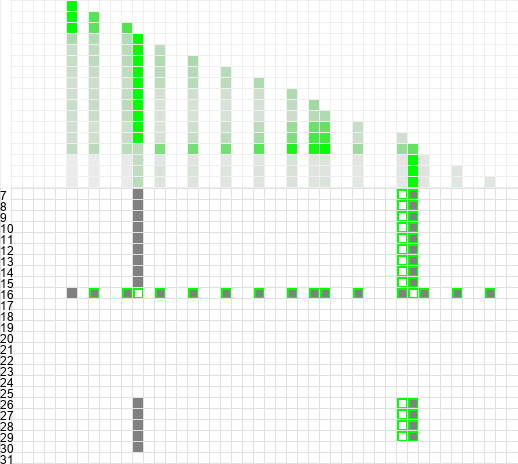

tensor([ 4.4865,  4.3211,  5.4695,  ..., 39.8901, 39.6735, 39.1811])
tensor([0.0000e+00, 0.0000e+00, 2.4140e-01,  ..., 3.3646e-01, 3.8331e-13,
        0.0000e+00])


In [47]:
pid=90
i_b = int(df1.iloc[pid]['i_b'])
i = int(df1.iloc[pid]['i'])
i_b,i
_,temp = cool_image(out1,i_b,i,opt1)
temp[0]


fig_cif = plot_cif(out1,i_b,i)
fig_cif

In [52]:
out1.keys()
out1['next_event_type_list'][10][94].shape
out1['event_type_list'][10][94].shape

dict_keys(['non_pad_mask_list', 'event_type_list', 'event_time_list', 'next_event_type_list', 'list_intens_at_samples', 'list_taus', 'list_true_intens_at_evs', 'list_log_sum', 'list_integral_', 'state_mod_list', 'state_time_list', 'state_value_list', 'r_enc_list', 'list_TE_att', 'list_DAM_att', 'y_pred', 'y_true', 'y_score', 'y_true_list', 'masks', 'y_state_pred', 'y_state_true', 'y_state_score'])

torch.Size([64, 24])

torch.Size([65, 24])

## K nearest

In [ ]:
df1.head(2)
df2.head(2)

## knn-ps

In [39]:
n_knn=5
pid_all = list(df1.index)

pid_positive = list(df1[df1.color_true=='Positive Samples'].index)

list_sim_score1 = []
list_sim_score2 = []

X1 = np.concatenate(out1['r_enc_list'],axis=0)[:,:model1.d_out_te]
X2 = np.concatenate(out2['r_enc_list'],axis=0)[:,:]

for pid in tqdm( pid_positive ):
    id_origin = pid

    knn_pids = find_knn_pids (X1, id_origin, n_knn=n_knn)
    sim_score1, list_summary = cal_similarity(df1, out1, pid, knn_pids)    


    knn_pids = find_knn_pids (X2, id_origin, n_knn=n_knn)
    sim_score2, list_summary = cal_similarity(df2, out2, pid, knn_pids)    
    
    if ( not np.isnan(sim_score1) ) and ( not np.isnan(sim_score2) ):
        list_sim_score1.append(sim_score1)
        list_sim_score2.append(sim_score2)

  0%|          | 0/400 [00:00<?, ?it/s]/tmp/ipykernel_16023/245538561.py:51: RuntimeWarning:

invalid value encountered in float_scalars

100%|██████████| 400/400 [00:02<00:00, 139.10it/s]


In [42]:
np.mean(list_sim_score1), np.std(list_sim_score1)
np.mean(list_sim_score2), np.std(list_sim_score2)

diff = np.array(list_sim_score1) - np.array(list_sim_score2)
diff.sum()/len(diff)
diff.argsort()


(0.86793864, 0.10793807)

(0.78286344, 0.11361882)

0.08507526957470438

array([240,  86,  10, 318, 225,  36, 271, 281,  51, 209, 329, 217,  44,
       126, 180, 229, 160, 187,  59, 161, 201, 270,  27, 241, 358, 200,
       322, 345,  83, 335,  78, 343, 108, 109,  80, 259, 127, 332, 272,
       244, 176, 136,  28, 140,  26, 323, 347, 327,  64, 157, 298,  96,
        97, 117, 268, 188, 208, 309,  46, 346, 112,  32, 134,  87, 124,
       204, 199,  84, 338, 262, 265,  77, 118, 190, 289,  69, 313, 247,
       303, 317, 282,  94, 105, 214, 304, 151,  68,  67, 337, 314, 291,
       167, 181, 139, 197,  71,  92, 250,  81,  22, 142,   1, 171, 116,
       110,  13, 205, 299,  85, 275, 156,  25, 349,  24,  50,  79, 254,
         0,  41,  30, 223, 158, 355, 119, 360, 111,  12,  98, 221, 341,
        19, 226, 245, 325, 145, 168, 101, 125,  54, 177, 286, 186, 253,
       293, 121, 301, 230, 137,  42, 305,   3, 357, 316, 148, 130,  57,
       178, 311, 326,  91, 120, 172, 162, 149, 238, 231, 348, 220, 210,
        53, 154, 364, 163, 288,  95, 129, 207, 147, 274,  45, 31

In [41]:
from scipy.stats import ttest_ind


group1 = [x-0.0 for x in list_sim_score1]
group2 = list_sim_score2
t_statistic, p_value = ttest_ind(group1, group2, alternative='greater')

# Print the results
print('t-statistic =', t_statistic)
print('p-value =', p_value)

t-statistic = 10.39975513919842
p-value = 5.02651028363944e-24


## plot knn

In [65]:
# # save selected to local
n_knn=5
id_origin = 90

len_CROP = len(opt1.dict_map_states.keys()) - len(opt1.dict_map_events.keys())
len_CROP

X1 = np.concatenate(out1['r_enc_list'],axis=0)[:,:model1.d_out_te]
X2 = np.concatenate(out2['r_enc_list'],axis=0)[:,:]


            # plot and save id_origin
i_b = df1.iloc[id_origin]['i_b']
i = df1.iloc[id_origin]['i']
im_url, temp = cool_image(out1,i_b,i,opt1)
im_url.save(f"./local/images/Origin_{id_origin}.png")

            # save event attentions
_,temp = cool_image(out1,i_b,i,opt1)
temp[0].save(f"./local/images/Origin_{id_origin}_att.png")

            # save cif plot
fig_cif = plot_cif(out1,i_b,i)
fig_cif.write_image(f"./local/images/Origin_{id_origin}_CIF.svg")


i_g=0
for out,opt,df,X in zip([out1,out2],[opt1,opt2],[df1,df2],[X1,X2]):
    knn_pids = find_knn_pids (X, id_origin, n_knn=n_knn)
    knn_pids
    for pid in knn_pids:
        # NEW
        i_b = df.iloc[pid]['i_b']
        i = df.iloc[pid]['i']
        im_url, temp = cool_image(out,i_b,i,opt,CROP=len_CROP)
        im_url.save(f"./local/images/C{i_g}_{pid}.png")



    i_g+=1

7

/tmp/ipykernel_16023/753296189.py:62: DeprecationWarning:

getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.



m=17
ev.shape=torch.Size([17, 25])
ev_pred.shape=torch.Size([17, 25])
tee_att.shape=torch.Size([4, 17])
tee_att_mat.shape=torch.Size([17, 17])
tee_att_mat_spaced.shape=(17, 44)
tensor([ 4.,  6.,  9., 10., 12., 15., 18., 21., 24., 26., 27., 30., 34., 35.,
        36., 39., 42.])
ev_matrix.shape=(25, 44)
44
ev_pred_matrix.shape=(25, 44)
m=17
ev.shape=torch.Size([17, 25])
ev_pred.shape=torch.Size([17, 25])
tee_att.shape=torch.Size([4, 17])
tee_att_mat.shape=torch.Size([17, 17])
tee_att_mat_spaced.shape=(17, 44)
tensor([ 4.,  6.,  9., 10., 12., 15., 18., 21., 24., 26., 27., 30., 34., 35.,
        36., 39., 42.])
ev_matrix.shape=(25, 44)
44
ev_pred_matrix.shape=(25, 44)
tensor([ 4.4865,  4.3211,  5.4695,  ..., 39.8901, 39.6735, 39.1811])
tensor([0.0000e+00, 0.0000e+00, 2.4140e-01,  ..., 3.3646e-01, 3.8331e-13,
        0.0000e+00])


[1039, 3187, 3601, 2291]

m=16
ev.shape=torch.Size([16, 25])
ev_pred.shape=torch.Size([16, 25])
tee_att.shape=torch.Size([4, 16])
tee_att_mat.shape=torch.Size([16, 16])
tee_att_mat_spaced.shape=(16, 51)
tensor([ 2.,  6., 11., 14., 15., 17., 18., 21., 25., 30., 34., 36., 38., 41.,
        45., 49.])
ev_matrix.shape=(25, 51)
51
ev_pred_matrix.shape=(25, 51)
m=17
ev.shape=torch.Size([17, 25])
ev_pred.shape=torch.Size([17, 25])
tee_att.shape=torch.Size([4, 17])
tee_att_mat.shape=torch.Size([17, 17])
tee_att_mat_spaced.shape=(17, 46)
tensor([ 3.,  4.,  5.,  7.,  8.,  9., 10., 11., 12., 16., 20., 21., 24., 31.,
        32., 36., 43.])
ev_matrix.shape=(25, 46)
46
ev_pred_matrix.shape=(25, 46)
m=14
ev.shape=torch.Size([14, 25])
ev_pred.shape=torch.Size([14, 25])
tee_att.shape=torch.Size([4, 14])
tee_att_mat.shape=torch.Size([14, 14])
tee_att_mat_spaced.shape=(14, 47)
tensor([ 7.,  8., 10., 12., 14., 18., 22., 26., 30., 34., 35., 38., 42., 46.])
ev_matrix.shape=(25, 47)
47
ev_pred_matrix.shape=(25, 47)
m=12
ev.shape=tor

[1155, 1318, 1767, 896]

## cif diff

$log(\lambda)$

In [117]:

pid_positive = list(df1[df1.color_true=='Positive Samples'].index)
pid_negative = list(df1[df1.color_true=='Negative Samples'].index)

list_sim_score1 = []
list_sim_score2 = []

lens = np.concatenate([x.sum(1).cpu().detach() for x in out1['non_pad_mask_list']])
X = np.concatenate(out1['list_log_sum'],axis=0) # [n_samples]
Y = np.concatenate(out1['list_integral_'],axis=0)/lens # [n_samples]


X[pid_positive].mean(), X[pid_positive].std()

X[pid_negative].mean(), X[pid_negative].std()



Y[pid_positive].mean(), Y[pid_positive].std()

Y[pid_negative].mean(), Y[pid_negative].std()


(-4.9485188, 9.586629)

(-6.501816, 6.51734)

(1.0763824, 0.311985)

(1.0075618, 0.32526162)

tensor([ 2.3167,  3.6167,  3.9167,  4.6167,  4.6833,  4.9167,  5.5833,  5.6833,
         5.9167,  6.9167,  7.7333,  7.9167,  8.9167,  9.2333,  9.9000, 10.2333,
        10.8333, 11.2500, 11.8333, 12.9667, 13.7500, 13.9667, 14.8833, 15.2833,
        15.7833, 15.9167, 16.7833, 16.9167, 17.0667, 18.0667, 18.8000, 21.0833,
        21.8667, 22.0833, 22.9167, 25.3833, 26.3833, 26.9167, 29.7667, 30.5667,
        30.7667, 30.9167, 32.4833, 33.4833, 34.9167, 35.4833, 36.1167, 36.4833,
        38.5833, 38.6833, 39.6833, 40.9167, 41.9167, 42.1000, 42.9167, 44.3833,
        44.7500, 45.3833, 46.9167, 47.3000])
ev_matrix.shape=(24, 48)
48
ev_pred_matrix.shape=(24, 48)
tensor([ 2.7282,  2.9976,  2.7748,  ..., 46.9940, 47.0181, 47.2123])
tensor([1.9014, 2.1420, 1.9721,  ..., 1.2533, 1.3225, 1.7837])


/tmp/ipykernel_6625/753296189.py:62: DeprecationWarning:

getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.



NUM:1139
binary_matrix.shape=(35, 48)
NUM:612
m=62
ev.shape=torch.Size([62, 24])
ev_pred.shape=torch.Size([62, 24])
tee_att.shape=torch.Size([4, 62])
binary_matrix.shape=(35, 48)
m=46
ev.shape=torch.Size([46, 24])
ev_pred.shape=torch.Size([46, 24])
tee_att.shape=torch.Size([4, 46])
tee_att_mat.shape=torch.Size([46, 46])
tee_att_mat_spaced.shape=(46, 48)
tee_att_mat.shape=torch.Size([62, 62])
tee_att_mat_spaced.shape=(62, 48)
NUM:1516
binary_matrix.shape=(35, 48)
m=25
ev.shape=torch.Size([25, 24])
ev_pred.shape=torch.Size([25, 24])
tee_att.shape=torch.Size([4, 25])
NUM:1360
binary_matrix.shape=(35, 48)
m=14
ev.shape=torch.Size([14, 24])
ev_pred.shape=torch.Size([14, 24])
tee_att.shape=torch.Size([4, 14])
NUM:227
binary_matrix.shape=(35, 48)
m=9
ev.shape=torch.Size([9, 24])
ev_pred.shape=torch.Size([9, 24])
tee_att.shape=torch.Size([4, 9])
tee_att_mat.shape=torch.Size([14, 14])
tee_att_mat_spaced.shape=(14, 48)
tee_att_mat.shape=torch.Size([9, 9])
tee_att_mat_spaced.shape=(9, 48)
tee_att

In [116]:
from scipy.stats import ttest_ind


group1 = X[pid_positive]
group2 = X[pid_negative]
t_statistic, p_value = ttest_ind(group1, group2, alternative='greater')

# Print the results
print('t-statistic =', t_statistic)
print('p-value =', p_value)


group1 = Y[pid_positive]
group2 = Y[pid_negative]
t_statistic, p_value = ttest_ind(group1, group2, alternative='greater')

# Print the results
print('t-statistic =', t_statistic)
print('p-value =', p_value)

t-statistic = 3.271740189616358
p-value = 0.0005446046738384706
t-statistic = 6.940219956957402
p-value = 2.7267961132785456e-12


integral

In [87]:

clusters = [

[1715, 1212, 957, 834, 1401, 1532, 33, 514, 559, 1493],
[1715, 1542, 808, 957, 1541, 1296, 252, 978, 34, 1204]



]



df = df1
out = out1

fig2 = go.Figure()
for i_c, cluster in enumerate(clusters):
    list_summary = []
    for pid in cluster:
        

        i_b = df.iloc[pid]['i_b']
        i = df.iloc[pid]['i']

        ev = out['event_type_list'][i_b][i]
        t = out['event_time_list'][i_b][i]
        st=out['state_time_list'][i_b][i]
        
        P = st.int().max().item() + 1

        M = event2mat(ev,t,P)

        

        vector = M.sum(1)/M.shape[1]*24

        
        list_summary.append(vector)
        

    dotp = [ np.dot(j,list_summary[0])/(np.linalg.norm(j) * np.linalg.norm(list_summary[0])) for  j in list_summary]
    np.mean( dotp )

    vec_mean = np.mean(list_summary,axis=0)
    vec_std = np.std(list_summary,axis=0)

    # sum(vec_std)

    
    _ = fig2.add_trace(go.Bar(
        name=f'Cluster {i_c}',
        x=list(res_labels), y=vec_mean,
        error_y=dict(type='data', array=vec_std)
    ))

fig2.show()

0.9599611

0.8721546

## save

In [66]:
fig_tsne1.write_image("local/images/fig1.svg")
fig_tsne2.write_image("local/images/fig2.svg")

NUM:3738
m=2
ev.shape=torch.Size([2, 25])
ev_pred.shape=torch.Size([2, 25])
tee_att.shape=torch.Size([4, 2])
tee_att_mat.shape=torch.Size([2, 2])
tee_att_mat_spaced.shape=(2, 7)
tensor([2., 6.])
ev_matrix.shape=(25, 7)
7
ev_pred_matrix.shape=(25, 7)
NUM:3567
m=4
ev.shape=torch.Size([4, 25])
ev_pred.shape=torch.Size([4, 25])
tee_att.shape=torch.Size([4, 4])
tee_att_mat.shape=torch.Size([4, 4])
tensor([5.6804, 4.4268, 2.1969, 4.0281, 2.0638, 2.2702, 2.0063, 3.8447, 3.4961,
        2.4540, 2.1489, 3.1908, 2.4185, 4.0455, 4.6275, 5.3611, 3.3872, 2.1030,
        5.3771, 2.9980, 2.7799, 4.3194, 2.8186, 5.1180, 4.6806, 5.7843, 2.7190,
        5.8009, 5.3662, 3.5515, 5.7951, 2.8582, 5.1345, 4.1436, 5.4306, 3.7236,
        4.2018, 5.1285, 3.1166, 4.9765, 2.0011, 4.9678, 5.2490, 2.7252, 2.8949,
        4.8002, 2.8249, 3.9586, 5.7292, 4.2639, 5.7771, 4.2737, 5.5460, 5.8912,
        4.3619, 4.1917, 3.5535, 5.5485, 3.8907, 4.2773, 3.0266, 4.4608, 2.2800,
        2.1616, 3.2307, 3.5093, 3.3200, 4.16

/tmp/ipykernel_16023/753296189.py:62: DeprecationWarning:

getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.



tensor([ 3.7670,  3.2460,  5.7553,  6.3350,  3.9362,  6.4801,  5.7488,  4.5455,
         3.6128,  4.9831,  4.5208,  6.7251,  5.8844,  3.7958,  3.8696,  6.9940,
         5.8227,  4.0243,  3.4142,  5.1836,  5.5700,  4.2768,  5.2053,  5.0336,
         6.9203,  4.9767,  6.6521,  4.2561,  6.4464,  4.0992,  3.8691,  5.1169,
         5.5432,  4.6268,  6.4535,  6.3559,  6.3861,  3.7662,  6.1138,  5.7811,
         3.7477,  4.1570,  4.2429,  3.1766,  3.1029,  4.9598,  3.7577,  5.0466,
         5.9389,  5.3618,  6.5919,  5.3282,  4.1082,  6.2458,  3.0087,  3.8371,
         3.5871,  6.5334,  5.9650,  6.5350,  4.5143,  5.2930,  5.4917,  4.3013,
         5.6006,  4.2477,  6.8461,  6.8374,  4.9989,  4.5186,  5.9896,  6.2476,
         4.8701,  4.1866,  3.7634,  6.2645,  5.2099,  3.5736,  5.4662,  6.1070,
         4.5490,  4.3660,  5.7148,  3.1102,  6.8898,  5.2226,  4.1881,  5.8784,
         6.4247,  5.0012,  3.3359,  6.8830,  6.6526,  5.2517,  5.5286,  3.9826,
         5.0291,  6.8866,  4.6913,  5.76

In [56]:
# # save selected to local
n_knn=5
id_origin = 420

X1 = np.concatenate(out1['r_enc_list'],axis=0)[:,:model1.d_out_te]
X2 = np.concatenate(out2['r_enc_list'],axis=0)[:,:]

i_g=0
for out,opt,df,X in zip([out1,out2],[opt1,opt2],[df1,df2],[X1,X2]):
    
    knn_pids = find_knn_pids (X, id_origin, n_knn=n_knn)
    knn_pids
    # for pid in knn_pids:
    #     # NEW
    #     i_b = df.iloc[pid]['i_b']
    #     i = df.iloc[pid]['i']
    #     im_url, temp = cool_image(out,i_b,i,opt,CROP=11)
    #     # im_url.save(f"./local/images/C{i_g}_{pid}.png")
    i_g+=1

[420, 462, 2413, 1826, 2660]

[420, 3211, 167, 2694, 1848]

In [43]:
new_fig =  go.Figure()
# new_fig = go.Figure(data=fig_prev['data'],layout=fig_prev['layout'])


# new_fig = bar_summary(df,out, point_ids,res_labels, fig=new_fig)

n_knn=5
id_origin = 583

X1 = np.concatenate(out1['r_enc_list'],axis=0)[:,:model1.d_out_te]
X2 = np.concatenate(out2['r_enc_list'],axis=0)[:,:]

new_fig = bar_summary(df,out, [id_origin],res_labels, fig=new_fig)

for out,opt,df,X in zip([out1,out2],[opt1,opt2],[df1,df2],[X1,X2]):
    knn_pids = find_knn_pids (X, id_origin, n_knn=n_knn)
    
    new_fig = bar_summary(df,out, knn_pids,res_labels, fig=new_fig)

new_fig
new_fig.write_image("local/images/bar.svg")

# CIF vis

In [88]:
df=df1
out=out1
pid_positive = list(df1[df1.color_true=='Positive Samples'].index)
pid_negative = list(df1[df1.color_true=='Negative Samples'].index)



fig=go.Figure()

for pid in pid_positive[:50]:

    i_b = int(df.iloc[pid]['i_b'])
    i = int(df.iloc[pid]['i'])
    taus,cifs_int = cif_cum(out1,i_b,i, fig=None)
    _ = fig.add_trace(go.Scatter(x=taus,y=cifs_int,marker=dict(
                    # size=2,
                    color='red',
                )))
    
for pid in pid_negative[:50]:

    i_b = int(df.iloc[pid]['i_b'])
    i = int(df.iloc[pid]['i'])
    taus,cifs_int = cif_cum(out1,i_b,i, fig=None)
    _ = fig.add_trace(go.Scatter(x=taus,y=cifs_int,marker=dict(
                    # size=2,
                    color='blue',
                )))


_=fig.update_layout(
        # autosize=False,
        # title=title,
        width=600,
        height=600,
        showlegend=False,

    )

fig

/tmp/ipykernel_22659/753296189.py:62: DeprecationWarning:

getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.



m=21
ev.shape=torch.Size([21, 24])
ev_pred.shape=torch.Size([21, 24])
tee_att.shape=torch.Size([4, 21])
tee_att_mat.shape=torch.Size([21, 21])
tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20])
ev_matrix.shape=(24, 21)
m=27
ev.shape=torch.Size([27, 24])
ev_pred.shape=torch.Size([27, 24])
tee_att.shape=torch.Size([4, 27])
tee_att_mat.shape=torch.Size([27, 27])
tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26])
ev_matrix.shape=(24, 27)
m=28
ev.shape=torch.Size([28, 24])
ev_pred.shape=torch.Size([28, 24])
tee_att.shape=torch.Size([4, 28])
tee_att_mat.shape=torch.Size([28, 28])
tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27])
ev_matrix.shape=(24, 28)


In [53]:
opt1.dict_map_events.keys()


for i,k in enumerate(opt1.dict_map_events.keys()):
    print(f'{i}:{k}')

dict_keys(['BUN', 'Creatinine', 'Glucose', 'HCO3', 'Potassium', 'Magnesium', 'Hct', 'Platelets', 'WBC', 'FiO2', 'PaCO2', 'pH', 'SaO2', 'Alkalinephos', 'AST', 'Bilirubin_total', 'Bilirubin_direct', 'Lactate', 'TroponinI', 'Hgb', 'Chloride', 'Phosphate', 'Calcium', 'PTT', 'Fibrinogen'])

0:BUN
1:Creatinine
2:Glucose
3:HCO3
4:Potassium
5:Magnesium
6:Hct
7:Platelets
8:WBC
9:FiO2
10:PaCO2
11:pH
12:SaO2
13:Alkalinephos
14:AST
15:Bilirubin_total
16:Bilirubin_direct
17:Lactate
18:TroponinI
19:Hgb
20:Chloride
21:Phosphate
22:Calcium
23:PTT
24:Fibrinogen


In [ ]:
0:BUN
1:Creatinine
2:Glucose
3:HCO3
4:Potassium
5:Magnesium
6:Hct
7:Platelets
8:WBC
9:FiO2
10:PaCO2
11:pH
12:SaO2
13:Alkalinephos
14:AST
15:Bilirubin_total
16:Bilirubin_direct
17:Lactate
18:TroponinI
19:Hgb
20:Chloride
21:Phosphate
22:Calcium
23:PTT
24:Fibrinogen